In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  999


In [2]:
# set up the directories
from pathgen.utils.seeds import set_seed
from pathgen.utils.paths import project_root

experiment_name = "one"
experiment_root = project_root() / "experiments" / experiment_name

train_patches_dir = experiment_root / 'camelyon16_patches_for_gan_training/train/tumor'

In [3]:
# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 256

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = torch.cuda.device_count()

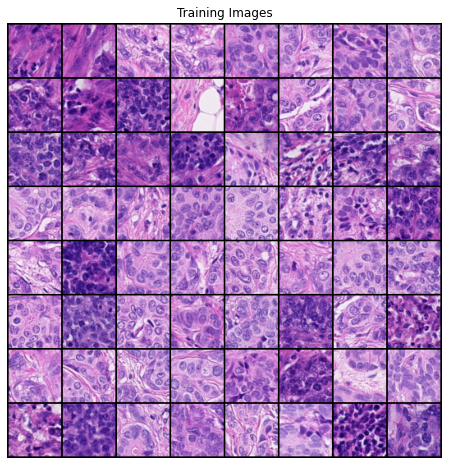

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=train_patches_dir,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    

In [10]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
%%time

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/200][0/118]	Loss_D: 1.5605	Loss_G: 5.8707	D(x): 0.5791	D(G(z)): 0.5245 / 0.0048
[0/200][50/118]	Loss_D: 0.5019	Loss_G: 7.3765	D(x): 0.6942	D(G(z)): 0.0021 / 0.0025
[0/200][100/118]	Loss_D: 0.5623	Loss_G: 2.0587	D(x): 0.7546	D(G(z)): 0.2025 / 0.1764
[1/200][0/118]	Loss_D: 0.9172	Loss_G: 4.6955	D(x): 0.9122	D(G(z)): 0.5307 / 0.0125
[1/200][50/118]	Loss_D: 0.4393	Loss_G: 4.8756	D(x): 0.8615	D(G(z)): 0.2282 / 0.0100
[1/200][100/118]	Loss_D: 0.6198	Loss_G: 5.8493	D(x): 0.8854	D(G(z)): 0.3652 / 0.0035
[2/200][0/118]	Loss_D: 0.4177	Loss_G: 4.5026	D(x): 0.9417	D(G(z)): 0.2756 / 0.0169
[2/200][50/118]	Loss_D: 1.2804	Loss_G: 2.1533	D(x): 0.3426	D(G(z)): 0.0193 / 0.1475
[2/200][100/118]	Loss_D: 0.6348	Loss_G: 3.2694	D(x): 0.5860	D(G(z)): 0.0290 / 0.0475
[3/200][0/118]	Loss_D: 0.4111	Loss_G: 3.4556	D(x): 0.7713	D(G(z)): 0.1039 / 0.0395
[3/200][50/118]	Loss_D: 0.3689	Loss_G: 3.4823	D(x): 0.8036	D(G(z)): 0.1144 / 0.0379
[3/200][100/118]	Loss_D: 1.4749	Loss_G: 4.7107	D(x)

[32/200][50/118]	Loss_D: 0.3002	Loss_G: 4.9559	D(x): 0.8724	D(G(z)): 0.1298 / 0.0102
[32/200][100/118]	Loss_D: 0.5023	Loss_G: 5.3099	D(x): 0.8301	D(G(z)): 0.2229 / 0.0083
[33/200][0/118]	Loss_D: 0.4027	Loss_G: 6.3840	D(x): 0.9391	D(G(z)): 0.2635 / 0.0024
[33/200][50/118]	Loss_D: 0.3502	Loss_G: 4.7421	D(x): 0.8525	D(G(z)): 0.1497 / 0.0119
[33/200][100/118]	Loss_D: 0.6784	Loss_G: 4.4319	D(x): 0.5758	D(G(z)): 0.0057 / 0.0210
[34/200][0/118]	Loss_D: 0.3865	Loss_G: 5.8630	D(x): 0.9161	D(G(z)): 0.2379 / 0.0040
[34/200][50/118]	Loss_D: 0.1587	Loss_G: 4.4612	D(x): 0.9259	D(G(z)): 0.0722 / 0.0158
[34/200][100/118]	Loss_D: 0.6079	Loss_G: 2.8568	D(x): 0.6096	D(G(z)): 0.0045 / 0.0768
[35/200][0/118]	Loss_D: 0.5077	Loss_G: 8.4312	D(x): 0.9701	D(G(z)): 0.3454 / 0.0003
[35/200][50/118]	Loss_D: 0.2745	Loss_G: 4.5570	D(x): 0.8780	D(G(z)): 0.1198 / 0.0154
[35/200][100/118]	Loss_D: 0.9146	Loss_G: 3.5465	D(x): 0.4829	D(G(z)): 0.0025 / 0.0570
[36/200][0/118]	Loss_D: 0.4013	Loss_G: 6.7474	D(x): 0.9266	D(G(z

[64/200][100/118]	Loss_D: 0.1421	Loss_G: 5.5486	D(x): 0.9399	D(G(z)): 0.0672 / 0.0059
[65/200][0/118]	Loss_D: 0.1234	Loss_G: 5.7564	D(x): 0.9321	D(G(z)): 0.0422 / 0.0058
[65/200][50/118]	Loss_D: 0.1501	Loss_G: 5.7030	D(x): 0.9622	D(G(z)): 0.0959 / 0.0058
[65/200][100/118]	Loss_D: 0.0461	Loss_G: 6.9341	D(x): 0.9840	D(G(z)): 0.0278 / 0.0022
[66/200][0/118]	Loss_D: 3.0649	Loss_G: 26.7015	D(x): 0.9998	D(G(z)): 0.9211 / 0.0000
[66/200][50/118]	Loss_D: 0.1491	Loss_G: 5.0845	D(x): 0.9152	D(G(z)): 0.0438 / 0.0103
[66/200][100/118]	Loss_D: 0.0629	Loss_G: 4.8261	D(x): 0.9557	D(G(z)): 0.0124 / 0.0147
[67/200][0/118]	Loss_D: 1.0908	Loss_G: 20.9976	D(x): 0.9969	D(G(z)): 0.5665 / 0.0000
[67/200][50/118]	Loss_D: 0.2261	Loss_G: 8.1752	D(x): 0.9885	D(G(z)): 0.1742 / 0.0005
[67/200][100/118]	Loss_D: 0.0653	Loss_G: 5.5810	D(x): 0.9588	D(G(z)): 0.0198 / 0.0064
[68/200][0/118]	Loss_D: 0.8856	Loss_G: 19.5127	D(x): 0.9936	D(G(z)): 0.5224 / 0.0000
[68/200][50/118]	Loss_D: 0.1387	Loss_G: 5.7308	D(x): 0.9200	D(

[97/200][0/118]	Loss_D: 0.1038	Loss_G: 6.0854	D(x): 0.9493	D(G(z)): 0.0451 / 0.0045
[97/200][50/118]	Loss_D: 0.1287	Loss_G: 5.3446	D(x): 0.9203	D(G(z)): 0.0315 / 0.0092
[97/200][100/118]	Loss_D: 0.0511	Loss_G: 5.2018	D(x): 0.9926	D(G(z)): 0.0404 / 0.0128
[98/200][0/118]	Loss_D: 0.5766	Loss_G: 8.3180	D(x): 0.9998	D(G(z)): 0.3237 / 0.0015
[98/200][50/118]	Loss_D: 0.1316	Loss_G: 6.9181	D(x): 0.9807	D(G(z)): 0.0949 / 0.0022
[98/200][100/118]	Loss_D: 0.1328	Loss_G: 6.0122	D(x): 0.9665	D(G(z)): 0.0853 / 0.0044
[99/200][0/118]	Loss_D: 0.1005	Loss_G: 6.2671	D(x): 0.9226	D(G(z)): 0.0102 / 0.0048
[99/200][50/118]	Loss_D: 0.1067	Loss_G: 5.7465	D(x): 0.9339	D(G(z)): 0.0298 / 0.0065
[99/200][100/118]	Loss_D: 0.1176	Loss_G: 5.5758	D(x): 0.9547	D(G(z)): 0.0602 / 0.0071
[100/200][0/118]	Loss_D: 0.6425	Loss_G: 15.2157	D(x): 0.9981	D(G(z)): 0.4026 / 0.0000
[100/200][50/118]	Loss_D: 0.0834	Loss_G: 3.1709	D(x): 0.9997	D(G(z)): 0.0706 / 0.0898
[100/200][100/118]	Loss_D: 0.1476	Loss_G: 6.7595	D(x): 0.9724	D

[129/200][0/118]	Loss_D: 0.7800	Loss_G: 11.8289	D(x): 1.0000	D(G(z)): 0.3420 / 0.0004
[129/200][50/118]	Loss_D: 0.1998	Loss_G: 5.1077	D(x): 0.9137	D(G(z)): 0.0833 / 0.0117
[129/200][100/118]	Loss_D: 0.0952	Loss_G: 5.4342	D(x): 0.9671	D(G(z)): 0.0513 / 0.0085
[130/200][0/118]	Loss_D: 0.3840	Loss_G: 12.5802	D(x): 0.9935	D(G(z)): 0.2487 / 0.0000
[130/200][50/118]	Loss_D: 0.0344	Loss_G: 5.1133	D(x): 0.9787	D(G(z)): 0.0116 / 0.0133
[130/200][100/118]	Loss_D: 0.1940	Loss_G: 7.6957	D(x): 0.8618	D(G(z)): 0.0001 / 0.0014
[131/200][0/118]	Loss_D: 1.3977	Loss_G: 26.4394	D(x): 0.9998	D(G(z)): 0.6628 / 0.0000
[131/200][50/118]	Loss_D: 0.0980	Loss_G: 6.0632	D(x): 0.9867	D(G(z)): 0.0740 / 0.0047
[131/200][100/118]	Loss_D: 0.1125	Loss_G: 5.1430	D(x): 0.9168	D(G(z)): 0.0108 / 0.0128
[132/200][0/118]	Loss_D: 0.1592	Loss_G: 8.5807	D(x): 0.9950	D(G(z)): 0.1061 / 0.0008
[132/200][50/118]	Loss_D: 0.0637	Loss_G: 6.5052	D(x): 0.9623	D(G(z)): 0.0174 / 0.0030
[132/200][100/118]	Loss_D: 0.1362	Loss_G: 4.7455	D(x

[161/200][0/118]	Loss_D: 1.4449	Loss_G: 26.2536	D(x): 0.9993	D(G(z)): 0.6471 / 0.0000
[161/200][50/118]	Loss_D: 0.2057	Loss_G: 7.1676	D(x): 0.9649	D(G(z)): 0.1313 / 0.0019
[161/200][100/118]	Loss_D: 0.0905	Loss_G: 5.2875	D(x): 0.9628	D(G(z)): 0.0443 / 0.0112
[162/200][0/118]	Loss_D: 0.9677	Loss_G: 16.9955	D(x): 0.9971	D(G(z)): 0.5243 / 0.0000
[162/200][50/118]	Loss_D: 0.0843	Loss_G: 5.8758	D(x): 0.9733	D(G(z)): 0.0505 / 0.0065
[162/200][100/118]	Loss_D: 0.0683	Loss_G: 5.3626	D(x): 0.9669	D(G(z)): 0.0308 / 0.0093
[163/200][0/118]	Loss_D: 4.7345	Loss_G: 25.7319	D(x): 1.0000	D(G(z)): 0.9770 / 0.0000
[163/200][50/118]	Loss_D: 0.1875	Loss_G: 5.1844	D(x): 0.9279	D(G(z)): 0.0773 / 0.0124
[163/200][100/118]	Loss_D: 0.0957	Loss_G: 5.2530	D(x): 0.9705	D(G(z)): 0.0571 / 0.0110
[164/200][0/118]	Loss_D: 1.3962	Loss_G: 20.9503	D(x): 0.9995	D(G(z)): 0.6411 / 0.0000
[164/200][50/118]	Loss_D: 0.1827	Loss_G: 4.2525	D(x): 0.8841	D(G(z)): 0.0283 / 0.0328
[164/200][100/118]	Loss_D: 0.1090	Loss_G: 4.6262	D(

[192/200][100/118]	Loss_D: 0.1307	Loss_G: 3.5351	D(x): 0.9261	D(G(z)): 0.0382 / 0.0611
[193/200][0/118]	Loss_D: 0.6451	Loss_G: 10.2396	D(x): 0.9898	D(G(z)): 0.3850 / 0.0001
[193/200][50/118]	Loss_D: 0.1967	Loss_G: 4.0870	D(x): 0.8886	D(G(z)): 0.0503 / 0.0362
[193/200][100/118]	Loss_D: 0.1326	Loss_G: 4.7758	D(x): 0.9352	D(G(z)): 0.0537 / 0.0193
[194/200][0/118]	Loss_D: 0.6265	Loss_G: 9.4549	D(x): 0.9963	D(G(z)): 0.3940 / 0.0002
[194/200][50/118]	Loss_D: 0.1650	Loss_G: 4.7190	D(x): 0.9740	D(G(z)): 0.1158 / 0.0180
[194/200][100/118]	Loss_D: 0.1319	Loss_G: 5.6439	D(x): 0.8989	D(G(z)): 0.0089 / 0.0082
[195/200][0/118]	Loss_D: 1.1876	Loss_G: 13.9884	D(x): 0.9918	D(G(z)): 0.5858 / 0.0000
[195/200][50/118]	Loss_D: 0.2143	Loss_G: 3.7013	D(x): 0.9084	D(G(z)): 0.0853 / 0.0547
[195/200][100/118]	Loss_D: 0.7644	Loss_G: 0.9472	D(x): 0.5860	D(G(z)): 0.0101 / 0.4915
[196/200][0/118]	Loss_D: 1.1497	Loss_G: 11.3933	D(x): 0.9957	D(G(z)): 0.5507 / 0.0000
[196/200][50/118]	Loss_D: 0.3008	Loss_G: 6.0998	D(x

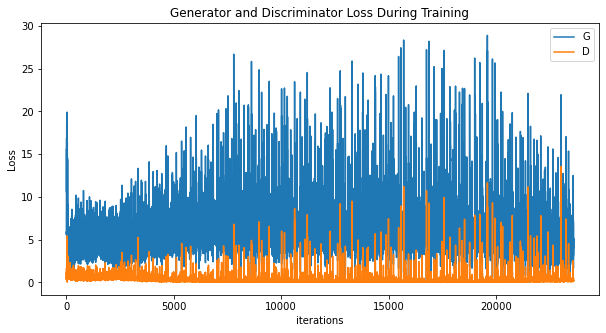

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21499120 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


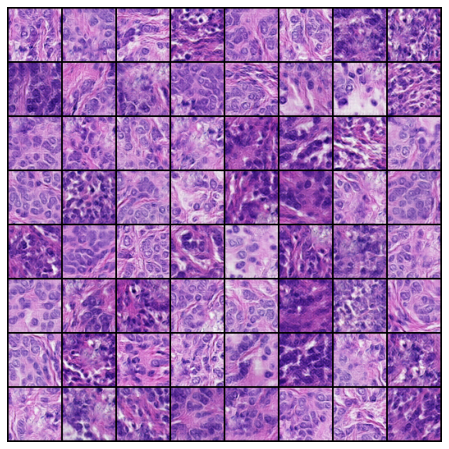

In [13]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

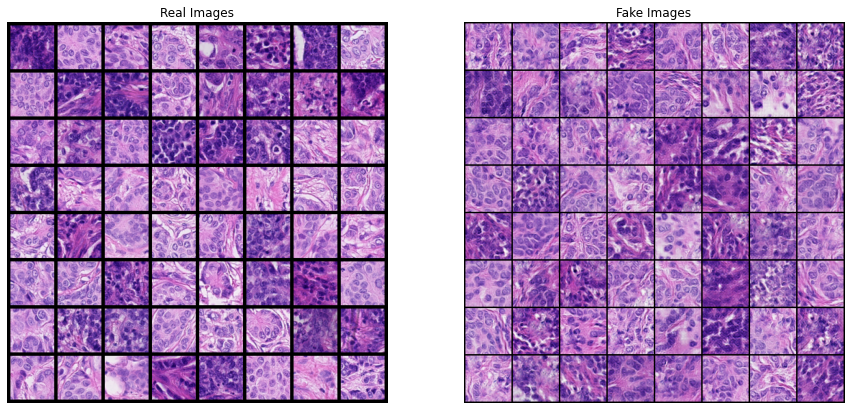

In [14]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [16]:
# we need 60,000 of these to do a fair test
30000 / 64

468.75

In [19]:
# so 938 batches and remove the last 32 (perhaps) - just get rid of it in sampling
from pathgen.utils.paths import project_root
from pathgen.utils.convert import np_to_pil

experiment_name = "one"
experiment_root = project_root() / "experiments" / experiment_name
output_dir = experiment_root / "fake_patches" / "tumor"

def generate_fake_batch(generator):
    b_size = 64
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    batch = generator(noise)
    images = []
    for sample in batch:
        MEAN = torch.tensor([0.5, 0.5, 0.5], device=device)
        STD = torch.tensor([0.5, 0.5, 0.5], device=device)
        x = sample * STD[:, None, None] + MEAN[:, None, None]
        image = x.detach().cpu().numpy().transpose(1,2,0)
        images.append(image)
    return images

for batch_idx in range(469):
    fake_batch = generate_fake_batch(netG)
    for img_idx, np_image in enumerate(fake_batch):
        img = np_to_pil(np_image)
        img.save(output_dir / f"{batch_idx}-{img_idx}.png")